In [37]:
import mysql_auth 
from MySQLConnection import *
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
import tensorflow as tf
from sklearn.model_selection import train_test_split
from matplotlib import pyplot as plt
from Modeling import *
import shap

In [2]:
# conn = MySQLConnection(DB_info=mysql_auth.NYXL_DB_Match_FinalStat)
# input_df = conn.read_all_tables_as_df()
# input_df.to_csv('input_df.csv')

In [3]:
input_df = pd.read_csv('input_df.csv')
display(input_df)

C:\Users\jyc13\anaconda3\envs\owl-data\lib\site-packages\IPython\core\interactiveshell.py:3166: DtypeWarning: Columns (6,42) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,Unnamed: 0,MatchId,num_map,Map,map_type,Section,RoundName,Timestamp,Team,Player,...,OffensiveAssists/s,RCP,FBValue,DeathRisk,TF_order,TF_winner,TF_duration,TF_RCP_sum,TF_RCP_weighted_sum,DominanceIndex
0,0,37147,1,Busan,CONTROL,1.0,Sanctuary,2021-05-02 23:20:23,Dallas Fuel,Doha,...,0.0,-1.750000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,1.195832
1,1,37147,1,Busan,CONTROL,1.0,Sanctuary,2021-05-02 23:20:23,Dallas Fuel,Fielder,...,0.0,-1.750000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,1.195832
2,2,37147,1,Busan,CONTROL,1.0,Sanctuary,2021-05-02 23:20:23,Dallas Fuel,Jecse,...,0.0,-1.750000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,1.195832
3,3,37147,1,Busan,CONTROL,1.0,Sanctuary,2021-05-02 23:20:23,Houston Outlaws,Crimzo,...,0.0,-1.750000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,1.195832
4,4,37147,1,Busan,CONTROL,1.0,Sanctuary,2021-05-02 23:20:23,Houston Outlaws,Happy,...,0.0,-1.750000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,1.195832
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4551233,4551233,37420,5,Nepal,CONTROL,3.0,Village,2021-07-17 05:34:52,Dallas Fuel,Jecse,...,1.0,1.833333,0.0,0.0,5.0,Dallas Fuel,14.118,1.833333,4.983517,0.337474
4551234,4551234,37420,5,Nepal,CONTROL,3.0,Village,2021-07-17 05:34:52,Dallas Fuel,Jecse,...,0.0,1.833333,0.0,0.0,5.0,Dallas Fuel,14.118,1.833333,4.983517,0.337474
4551235,4551235,37420,5,Nepal,CONTROL,3.0,Village,2021-07-17 05:34:52,Dallas Fuel,SP9RK1E,...,0.0,1.833333,0.0,0.0,5.0,Dallas Fuel,14.118,1.833333,4.983517,0.337474
4551236,4551236,37420,5,Nepal,CONTROL,3.0,Village,2021-07-17 05:34:52,Dallas Fuel,SP9RK1E,...,0.0,1.833333,0.0,0.0,5.0,Dallas Fuel,14.118,1.833333,4.983517,0.337474


In [4]:
input_df['position_x'] = input_df['position'].str.split(',').str[0].astype('float')
input_df['position_y'] = input_df['position'].str.split(',').str[2].astype('float')
input_df['position_z'] = input_df['position'].str.split(',').str[1].astype('float')

In [5]:
def get_distance_from_center(input_df):
    input_df[['position_x_norm', 'position_y_norm', 'position_z_norm']] = input_df.groupby(['MatchId', 'num_map', 'Section'])[['position_x', 'position_y', 'position_z']].apply(lambda x: (x - x.min()) / (x.max() - x.min()) )
    avg_position_x = input_df.groupby(['MatchId', 'num_map', 'Section', 'Timestamp', 'Team'])[['position_x_norm']].mean()
    avg_position_y = input_df.groupby(['MatchId', 'num_map', 'Section', 'Timestamp', 'Team'])[['position_y_norm']].mean()
    avg_position_z = input_df.groupby(['MatchId', 'num_map', 'Section', 'Timestamp', 'Team'])[['position_z_norm']].mean()

    input_df = input_df.set_index(['MatchId', 'num_map', 'Section', 'Timestamp', 'Team'])

    df_merge = pd.merge(input_df, avg_position_x, left_index=True, right_index=True, suffixes=('', '_avg'))
    df_merge = pd.merge(df_merge, avg_position_y, left_index=True, right_index=True, suffixes=('', '_avg'))
    df_merge = pd.merge(df_merge, avg_position_z, left_index=True, right_index=True, suffixes=('', '_avg'))

    df_merge.dropna(axis=0, how='any', inplace=True)
    df_merge['distance_from_center'] = ((df_merge['position_x_norm_avg'] - df_merge['position_x_norm'])**2 + (df_merge['position_y_norm_avg'] - df_merge['position_y_norm'])**2 + (df_merge['position_z_norm_avg'] - df_merge['position_z_norm'])**2)**(1/2)

    output_df = df_merge.reset_index()
    return output_df

In [6]:
input_df = get_distance_from_center(input_df)

In [7]:
from scipy.spatial import ConvexHull

def ConvHullArea(X):
    # X = X[X.loc[:,'IsAlive']==1]
    X = X[X['IsAlive']==1]
    points = X.iloc[:,1:3].values
    try:
        hull = ConvexHull(points)
        area = hull.area
    except: 
        area = 0
    return area

df_points = input_df.groupby(['MatchId', 'num_map', 'Map', 'Section', 'Timestamp', 'Team'])[['IsAlive', 'position_x', 'position_y']].apply(ConvHullArea)

df_points = df_points.reset_index()
df_points.rename(columns={0:'ConvHullArea'}, inplace=True)

df_merge = pd.merge(input_df, df_points, how='outer', on=['MatchId', 'num_map', 'Map', 'Section', 'Timestamp', 'Team'])

In [8]:
selected_features = [
    'FinalBlows/s', 'Deaths/s',
    'TimePlayed/s', 'HeroDamageDealt/s', 'BarrierDamageDealt/s', 
    'HeroDamageTaken/s', 'HealingDealt/s', 'HealingReceived/s', 
    'EnvironmentalDeaths/s', 'EnvironmentalKills/s', 'SoloKills/s', 
    'UltimatesUsed/s', 'distance_from_center', 'ConvHullArea'
]
# selected_features = [
#     'FBValue', 'DeathRisk',
#     'TimePlayed/s', 'HeroDamageDealt/s', 'BarrierDamageDealt/s', 
#     'HeroDamageTaken/s', 'HealingDealt/s', 'HealingReceived/s', 
#     'EnvironmentalDeaths/s', 'EnvironmentalKills/s', 'SoloKills/s', 
#     'UltimatesUsed/s', 'distance_from_center', 'ConvHullArea'
# ]

In [9]:
HeroList = [
    'Ana','Ashe', 'Baptiste', 'Bastion', 'Brigitte', 'D.Va', 'Doomfist', 'Echo', 'Genji',
    'Hanzo', 'Junkrat', 'Lucio', 'McCree', 'Mei', 'Mercy', 'Moira', 'Orisa', 'Pharah', 'Reaper',
    'Reinhardt', 'Roadhog', 'Sigma', 'Soldier: 76', 'Sombra', 'Symmetra', 'Torbjorn', 'Tracer', 'Widowmaker',
    'Winston', 'Wrecking Ball', 'Zarya', 'Zenyatta'
]

In [26]:
df_init = df_merge[df_merge['TF_order'].notna()]
df_init['IsTFWinner'] = df_init['Team'] == df_init['TF_winner'] # TF_winner
df_init['IsMapWinner'] = df_init['Team'] == df_init['MapWinner'] # Map_winner
target_flag = 'Teamfight' # Map or Teamfight

if target_flag == 'Map':
    grouping_index = ['MatchId', 'num_map', 'Map', 'Team']
    target = 'IsMapWinner'
elif target_flag == 'Teamfight':
    grouping_index = ['MatchId', 'num_map', 'Map', 'Section', 'TF_order', 'Team', 'Player', 'Hero']
    target = 'IsTFWinner'

df_init = df_init[df_init['TimePlayed/s'] != 0]
df_X = df_init.groupby(grouping_index)[selected_features + [target]].sum()

df_X.replace({False:0, True:1}, inplace=True)
df_X.loc[df_X[target] != 0, target] = 1

df_y = df_X[target]
df_X = df_X.drop(target, axis=1)
df_X = df_X.drop([x for x in df_X.columns if x.startswith('Hero_')], axis=1) # drop HeroComp

# df_X_norm = df_X.groupby([x for x in grouping_index if x != 'Team']).apply(lambda x: x/x.sum()) # 팀 상대적으로 비교하기 위해 normalization
df_X_norm = df_X.fillna(0)

display(df_X_norm)
display(df_y)

FinalBlows/s  \
MatchId num_map Map   Section TF_order Team        Player   Hero                      
37147   1       Busan 1.0     1.0      Dallas Fuel Doha     Sombra              1.0   
                                                   Fearless Winston             0.0   
                                                   Fielder  Moira               0.0   
                                                   HanBin   D.Va                0.0   
                                                   Jecse    Lucio               0.0   
...                                                                             ...   
37420   5       Nepal 3.0     5.0      Dallas Fuel Fearless Reinhardt           1.0   
                                                   Fielder  Baptiste            0.0   
                                                   HanBin   D.Va                0.0   
                                                   Jecse    Lucio               0.0   
                                                   SP9RK1E  Symmetra            0.0   

                                                                       Deaths/s  \
MatchId num_map Map   Section TF_order Team        Player   Hero                  
37147   1       Busan 1.0     1.0      Dallas Fuel Doha     Sombra          0.0   
                                                   Fearless Winston         0.0   
                                                   Fielder  Moira           0.0   
                                                   HanBin   D.Va            0.0   
                                                   Jecse    Lucio           1.0   
...                                                                         ...   
37420   5       Nepal 3.0     5.0      Dallas Fuel Fearless Reinhardt       0.0   
                                                   Fielder  Baptiste        0.0   
                                                   HanBin   D.Va            0.0   
                                                   Jecse    Lucio           0.0   
                                                   SP9RK1E  Symmetra        0.0   

                                                                       TimePlayed/s  \
MatchId num_map Map   Section TF_order Team        Player   Hero                      
37147   1       Busan 1.0     1.0      Dallas Fuel Doha     Sombra          26.2836   
                                                   Fearless Winston         26.2836   
                                                   Fielder  Moira           26.2836   
                                                   HanBin   D.Va            26.2836   
                                                   Jecse    Lucio           26.2836   
...                                                                             ...   
37420   5       Nepal 3.0     5.0      Dallas Fuel Fearless Reinhardt       16.5560   
                                                   Fielder  Baptiste        16.5560   
                                                   HanBin   D.Va            16.5550   
                                                   Jecse    Lucio           16.5550   
                                                   SP9RK1E  Symmetra        16.5560   

                                                                       HeroDamageDealt/s  \
MatchId num_map Map   Section TF_order Team        Player   Hero                           
37147   1       Busan 1.0     1.0      Dallas Fuel Doha     Sombra             566.34600   
                                                   Fearless Winston            459.79130   
                                                   Fielder  Moira               60.62000   
                                                   HanBin   D.Va               642.95066   
                                                   Jecse    Lucio              135.00000   
...                                                                                

MatchId  num_map  Map    Section  TF_order  Team         Player    Hero     
37147    1        Busan  1.0      1.0       Dallas Fuel  Doha      Sombra       1
                                                         Fearless  Winston      1
                                                         Fielder   Moira        1
                                                         HanBin    D.Va         1
                                                         Jecse     Lucio        1
                                                                               ..
37420    5        Nepal  3.0      5.0       Dallas Fuel  Fearless  Reinhardt    1
                                                         Fielder   Baptiste     1
                                                         HanBin    D.Va         1
                                                         Jecse     Lucio        1
                                                         SP9RK1E   Symmetra     1
Name: IsTFWinner, Len

In [39]:
def learning(df_X_norm, df_y):
    #
    X = df_X_norm.values
    y = df_y.values
    feature_names = df_X_norm.columns 
    scaler = RobustScaler()
    X = scaler.fit_transform(X)
    print(X.shape, y.shape)
    #
    dnn = ModelDNN(X=X, y=y) 
    dnn.create_model()
    #
    dnn.train_model(num_epoch=30000, batch_size=5000, patience=300, verbose=0)
    dnn.model.evaluate(dnn.X_test, dnn.y_test, batch_size=3000, verbose=0)
    # load JS visualization code to notebook
    shap.initjs()

    # explain the model
    explainer = shap.GradientExplainer(dnn.model, dnn.X_train)
    shap_values = explainer.shap_values(dnn.X_train)

    # plot
    # shap.summary_plot(shap_values, dnn.X_test, feature_names=feature_names)
    shap.summary_plot(shap_values[0], dnn.X_train, feature_names=feature_names)

Ana
(1395, 14) (1395,)
X_train shape :  (934, 14)
y_train shape :  (934,)
X_test shape :  (461, 14)
y_test shape :  (461,)
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_12 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_8 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_13 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_9 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_14 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
_____________________________________________________________

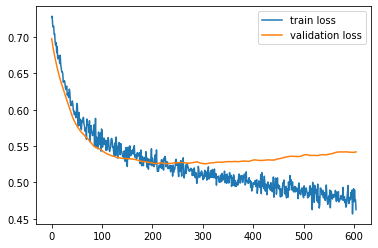

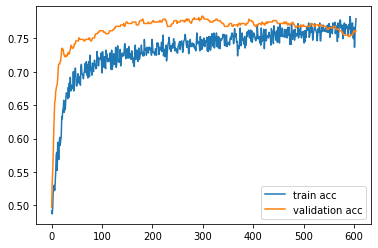

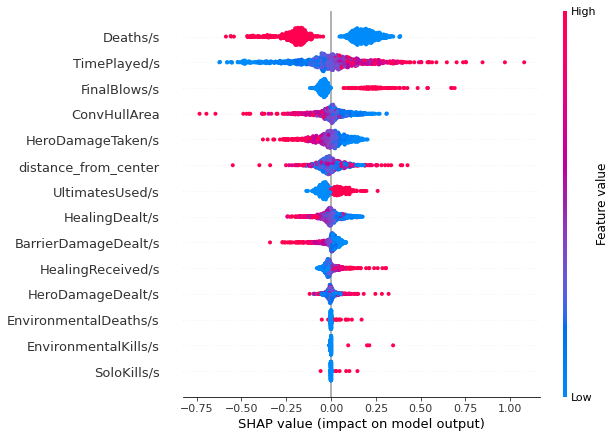

Ashe
(393, 14) (393,)
X_train shape :  (263, 14)
y_train shape :  (263,)
X_test shape :  (130, 14)
y_test shape :  (130,)
Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_18 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_12 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_19 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_13 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_20 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
______________________________________________________________

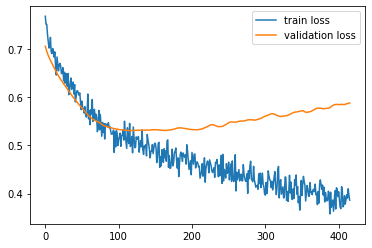

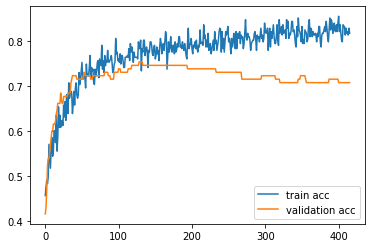

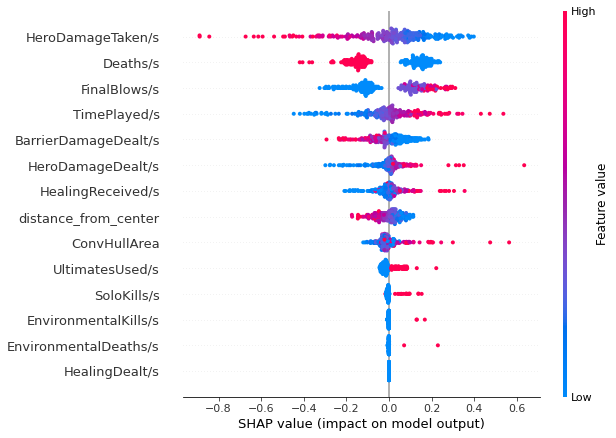

Baptiste
(1895, 14) (1895,)
X_train shape :  (1269, 14)
y_train shape :  (1269,)
X_test shape :  (626, 14)
y_test shape :  (626,)
Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_24 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_16 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_25 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_17 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_26 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
______________________________________________________

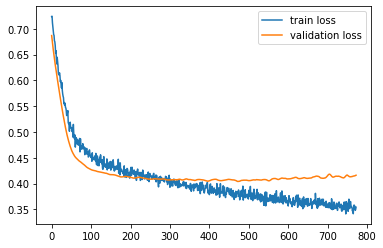

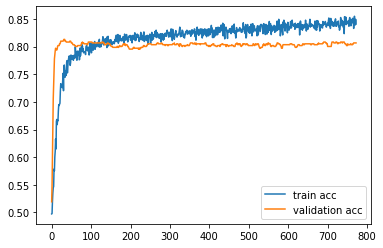

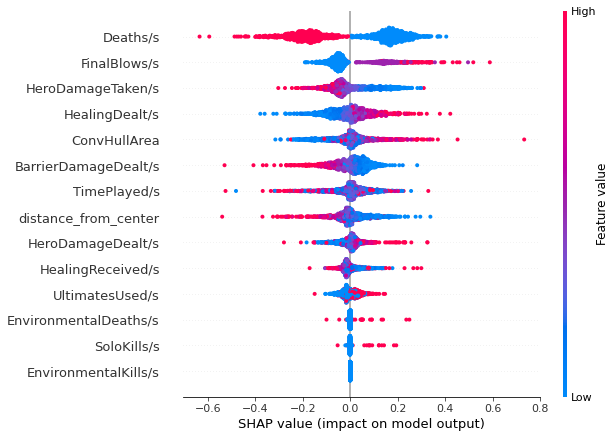

Brigitte
(1884, 14) (1884,)
X_train shape :  (1262, 14)
y_train shape :  (1262,)
X_test shape :  (622, 14)
y_test shape :  (622,)
Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_30 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_20 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_31 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_21 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_32 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
_____________________________________________________

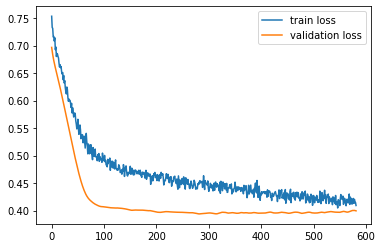

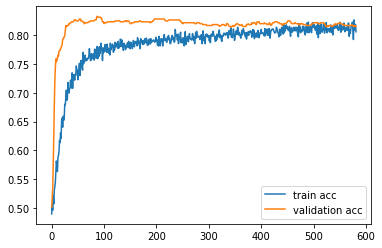

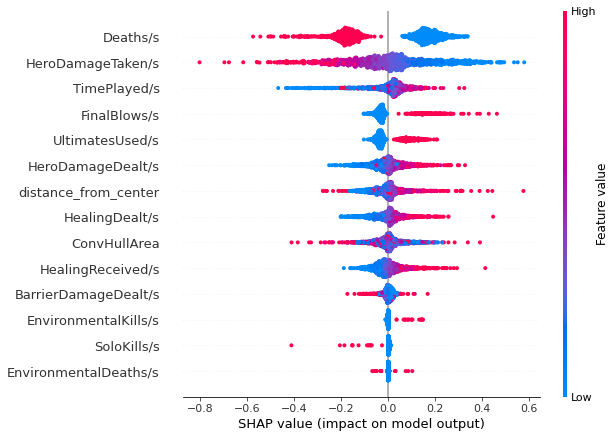

D.Va
(3902, 14) (3902,)
X_train shape :  (2614, 14)
y_train shape :  (2614,)
X_test shape :  (1288, 14)
y_test shape :  (1288,)
Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_36 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_24 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_37 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_25 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_38 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
_______________________________________________________

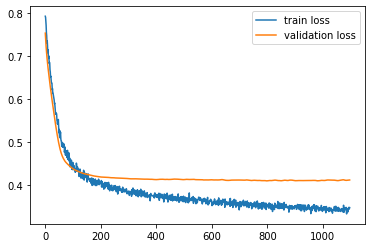

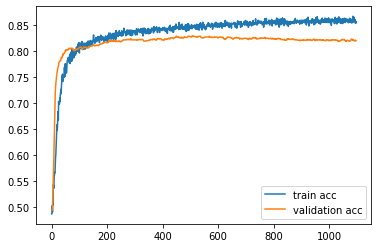

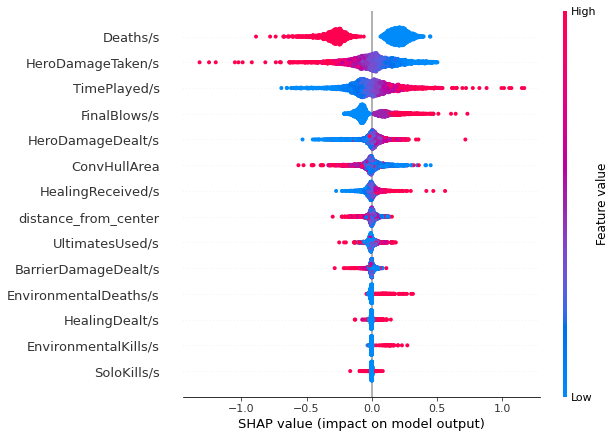

Doomfist
(463, 14) (463,)
X_train shape :  (310, 14)
y_train shape :  (310,)
X_test shape :  (153, 14)
y_test shape :  (153,)
Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_42 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_28 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_43 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_29 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_44 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
_________________________________________________________

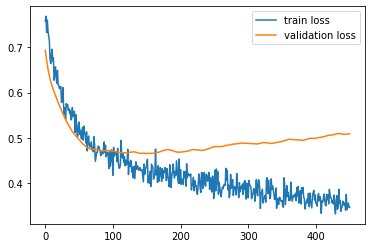

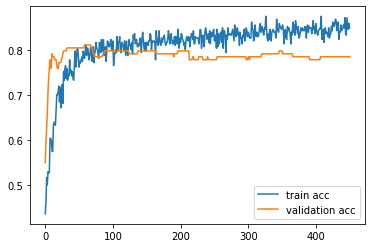

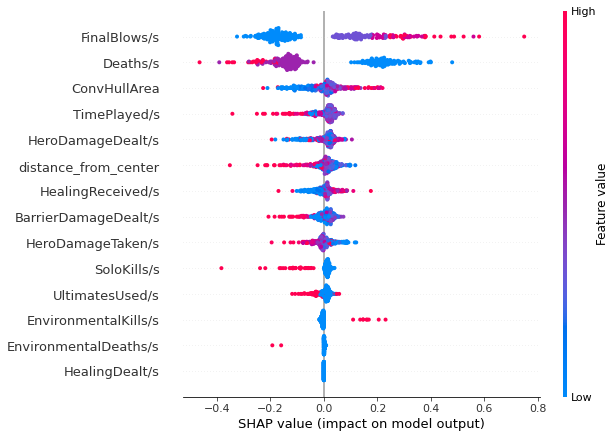

Echo
(1270, 14) (1270,)
X_train shape :  (850, 14)
y_train shape :  (850,)
X_test shape :  (420, 14)
y_test shape :  (420,)
Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_48 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_32 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_49 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_33 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_50 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
___________________________________________________________

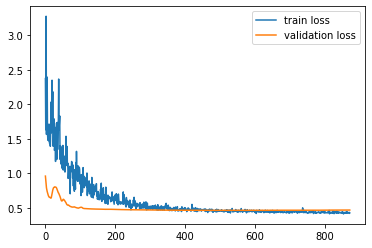

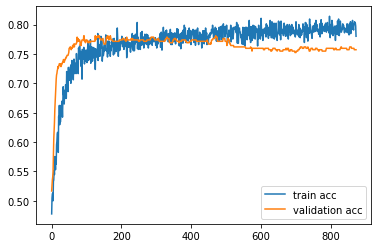

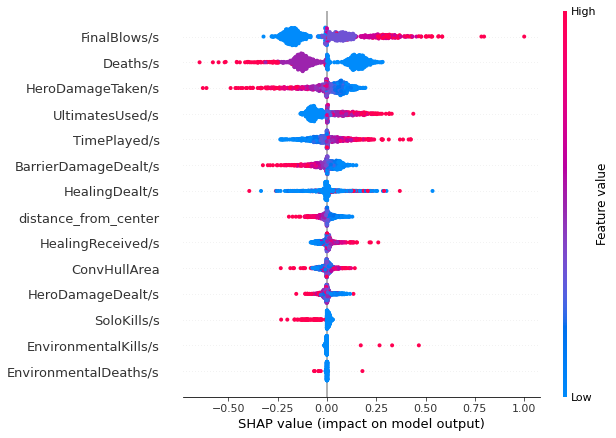

Genji
(43, 14) (43,)
X_train shape :  (28, 14)
y_train shape :  (28,)
X_test shape :  (15, 14)
y_test shape :  (15,)
Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_54 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_36 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_55 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_37 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_56 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
_________________________________________________________________


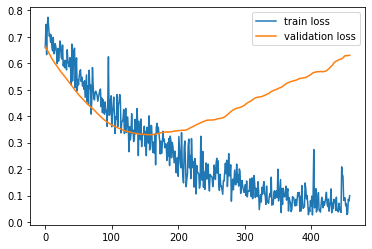

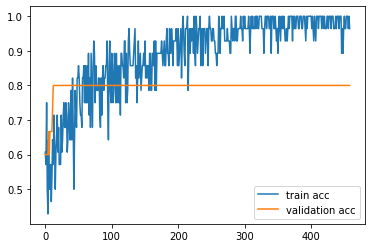

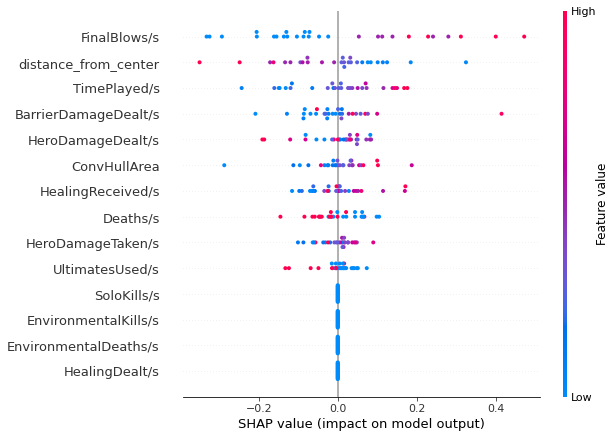

Hanzo
(153, 14) (153,)
X_train shape :  (102, 14)
y_train shape :  (102,)
X_test shape :  (51, 14)
y_test shape :  (51,)
Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_60 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_40 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_61 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_41 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_62 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
______________________________________________________________

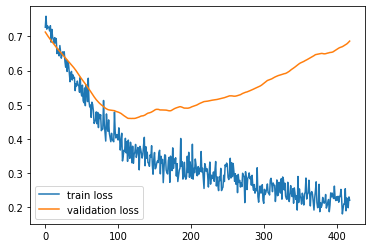

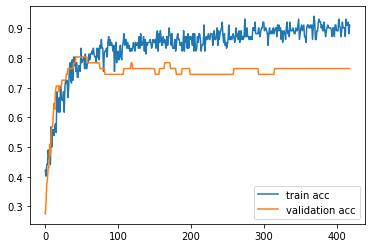

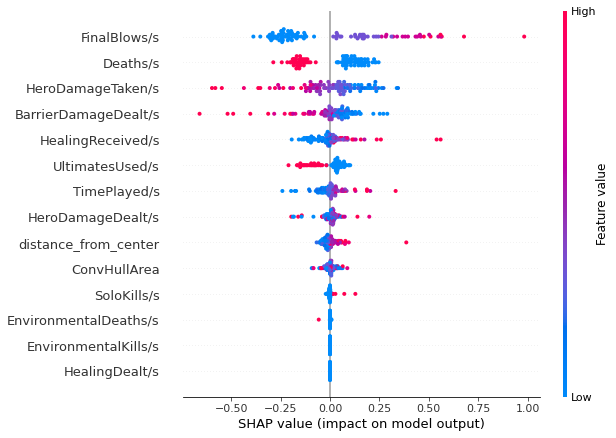

Junkrat
(57, 14) (57,)
X_train shape :  (38, 14)
y_train shape :  (38,)
X_test shape :  (19, 14)
y_test shape :  (19,)
Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_66 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_44 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_67 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_45 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_68 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
________________________________________________________________

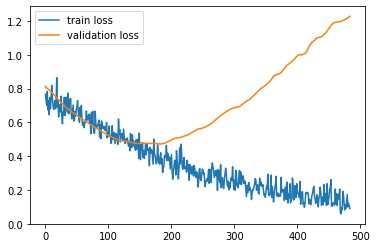

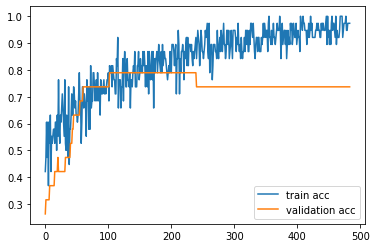

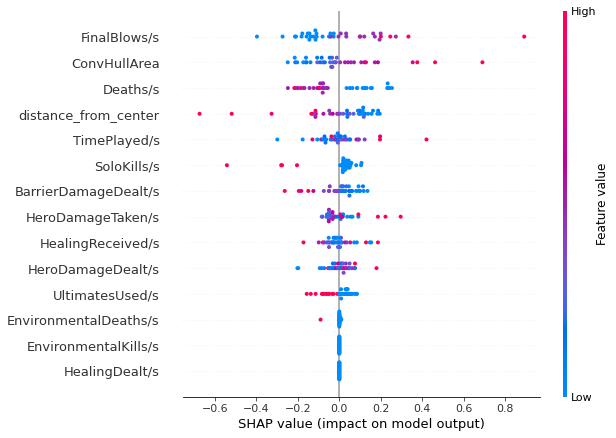

Lucio
(2412, 14) (2412,)
X_train shape :  (1616, 14)
y_train shape :  (1616,)
X_test shape :  (796, 14)
y_test shape :  (796,)
Model: "sequential_24"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_72 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_48 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_73 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_49 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_74 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
________________________________________________________

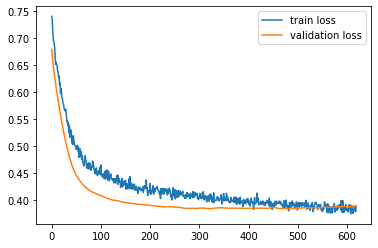

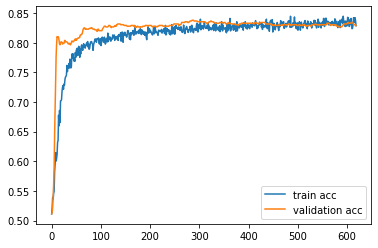

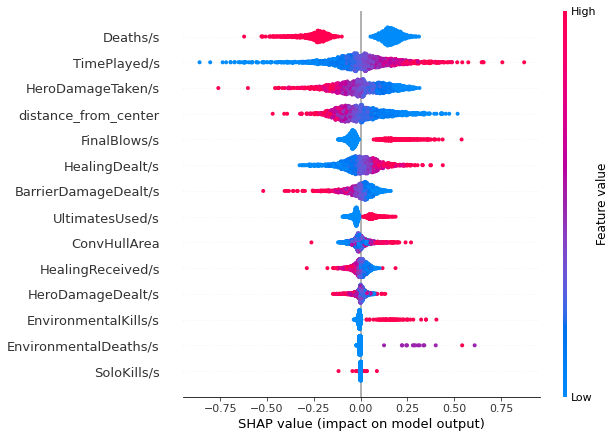

McCree
(1296, 14) (1296,)
X_train shape :  (868, 14)
y_train shape :  (868,)
X_test shape :  (428, 14)
y_test shape :  (428,)
Model: "sequential_26"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_78 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_52 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_79 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_53 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_80 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
_________________________________________________________

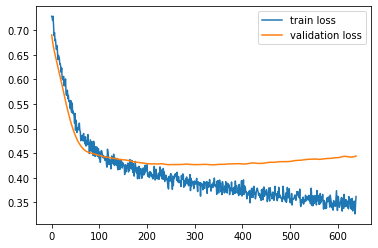

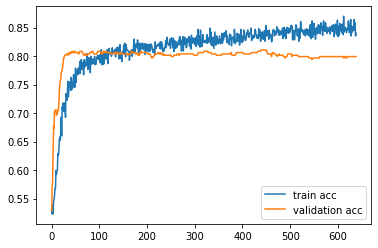

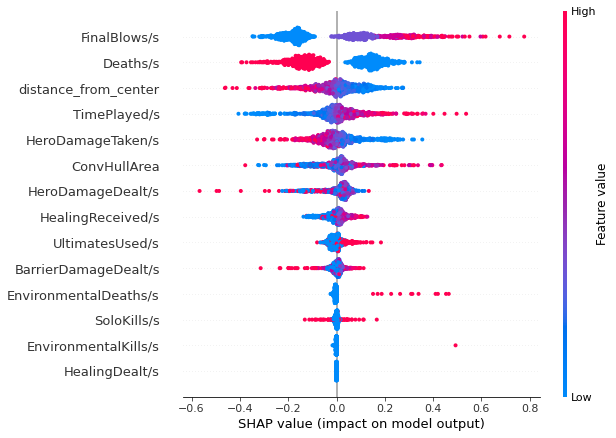

Mei
(1086, 14) (1086,)
X_train shape :  (727, 14)
y_train shape :  (727,)
X_test shape :  (359, 14)
y_test shape :  (359,)
Model: "sequential_28"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_84 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_56 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_85 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_57 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_86 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
____________________________________________________________

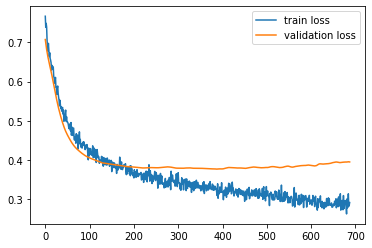

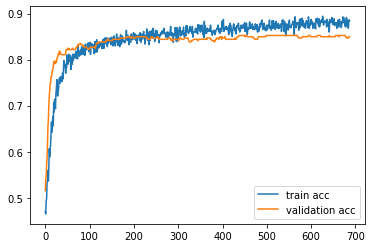

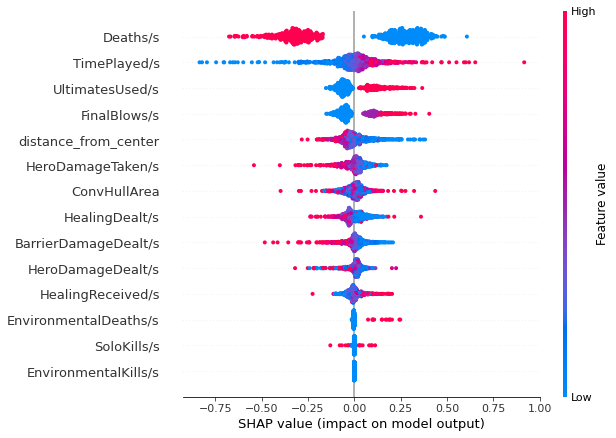

Mercy
(717, 14) (717,)
X_train shape :  (480, 14)
y_train shape :  (480,)
X_test shape :  (237, 14)
y_test shape :  (237,)
Model: "sequential_30"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_90 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_60 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_91 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_61 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_92 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
____________________________________________________________

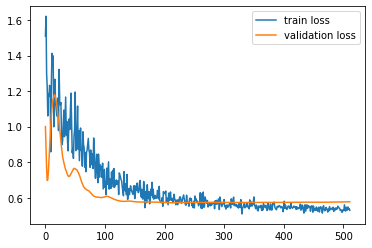

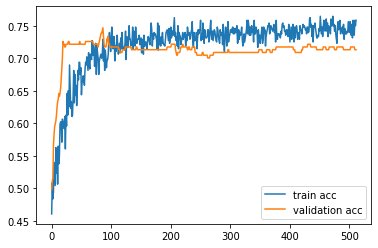

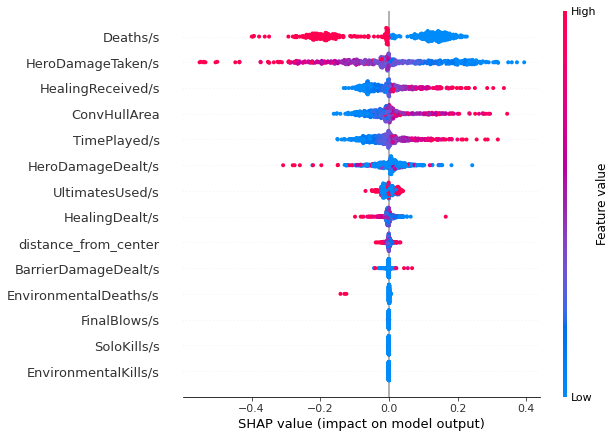

Moira
(862, 14) (862,)
X_train shape :  (577, 14)
y_train shape :  (577,)
X_test shape :  (285, 14)
y_test shape :  (285,)
Model: "sequential_32"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_96 (Dense)             (None, 64)                960       
_________________________________________________________________
dropout_64 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_97 (Dense)             (None, 64)                4160      
_________________________________________________________________
dropout_65 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_98 (Dense)             (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
____________________________________________________________

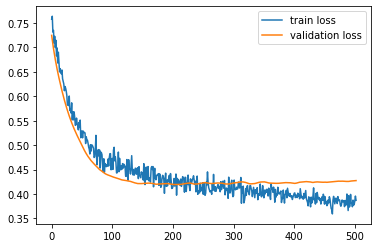

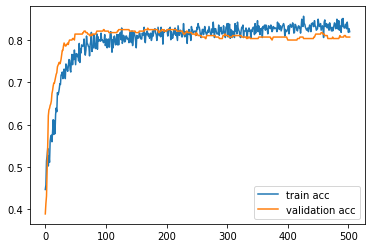

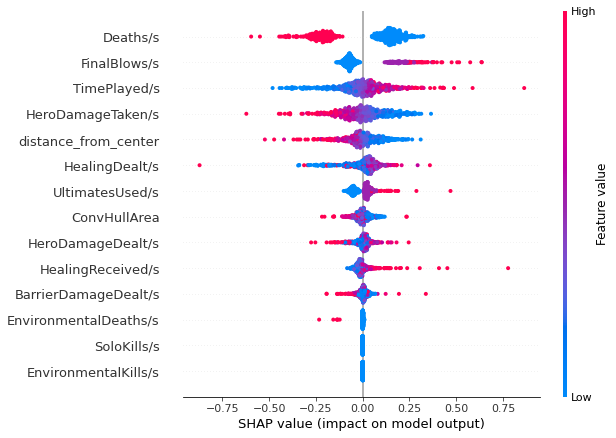

Orisa
(574, 14) (574,)
X_train shape :  (384, 14)
y_train shape :  (384,)
X_test shape :  (190, 14)
y_test shape :  (190,)
Model: "sequential_34"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_102 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_68 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_103 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_69 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_104 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
____________________________________________________________

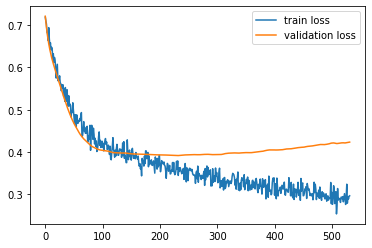

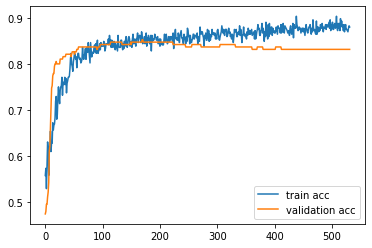

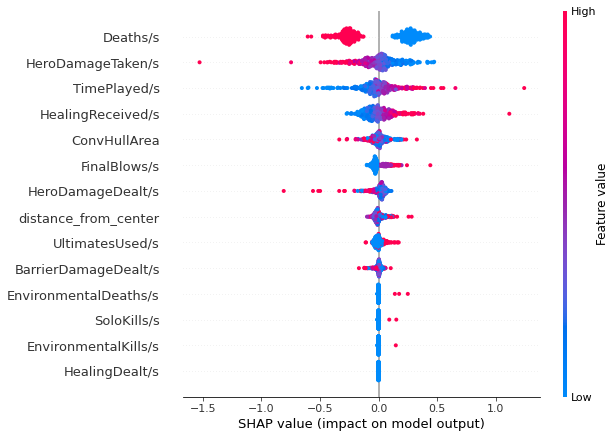

Pharah
(409, 14) (409,)
X_train shape :  (274, 14)
y_train shape :  (274,)
X_test shape :  (135, 14)
y_test shape :  (135,)
Model: "sequential_36"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_108 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_72 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_109 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_73 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_110 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
___________________________________________________________

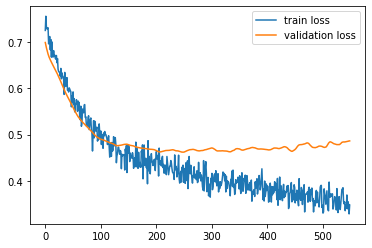

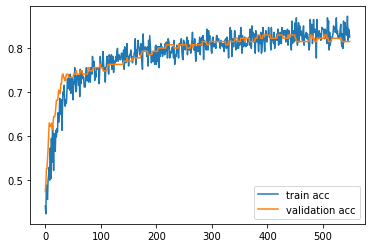

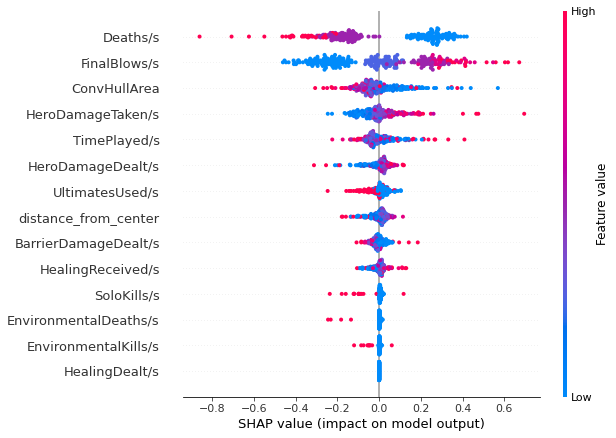

Reaper
(911, 14) (911,)
X_train shape :  (610, 14)
y_train shape :  (610,)
X_test shape :  (301, 14)
y_test shape :  (301,)
Model: "sequential_38"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_114 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_76 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_115 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_77 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_116 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
___________________________________________________________

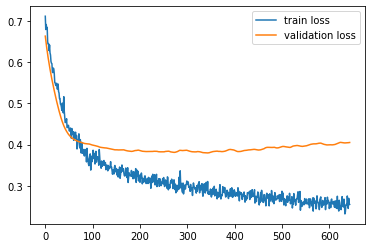

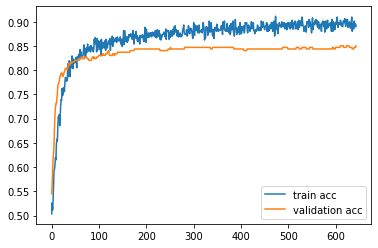

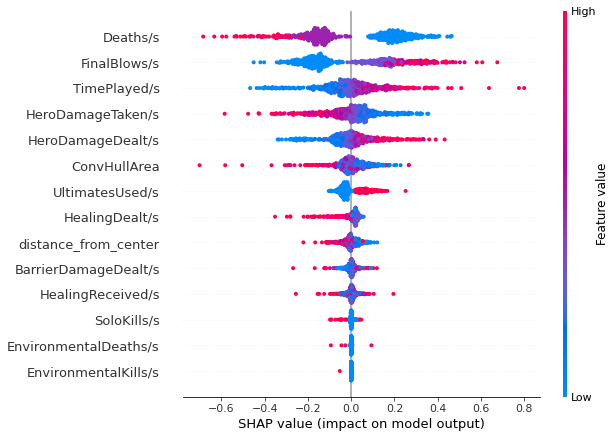

Reinhardt
(1402, 14) (1402,)
X_train shape :  (939, 14)
y_train shape :  (939,)
X_test shape :  (463, 14)
y_test shape :  (463,)
Model: "sequential_40"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_120 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_80 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_121 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_81 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_122 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
______________________________________________________

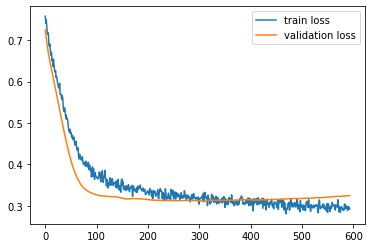

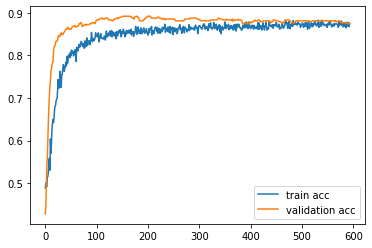

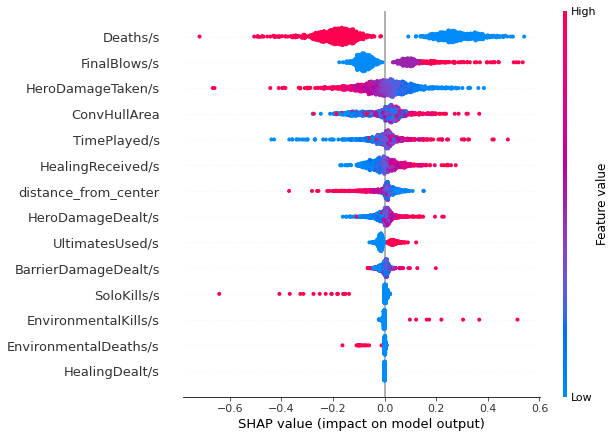

Roadhog
(19, 14) (19,)
X_train shape :  (12, 14)
y_train shape :  (12,)
X_test shape :  (7, 14)
y_test shape :  (7,)
Model: "sequential_42"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_126 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_84 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_127 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_85 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_128 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
_________________________________________________________________


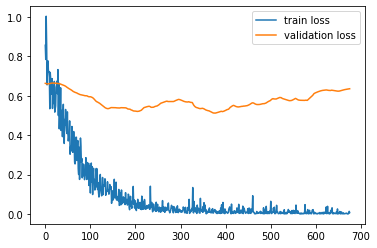

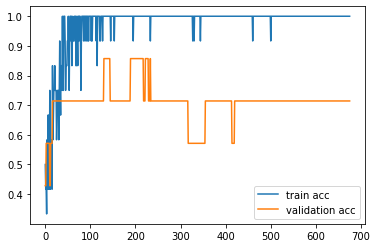

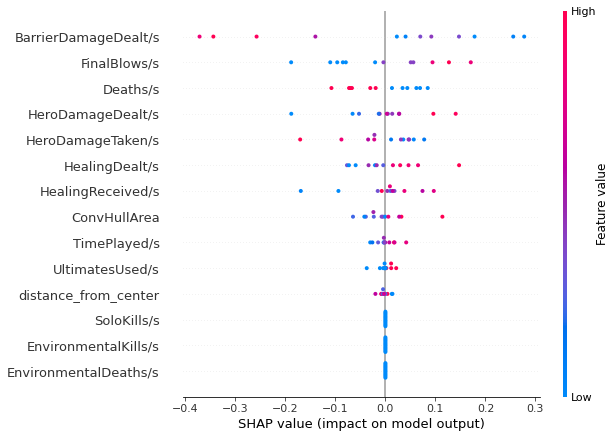

Sigma
(638, 14) (638,)
X_train shape :  (427, 14)
y_train shape :  (427,)
X_test shape :  (211, 14)
y_test shape :  (211,)
Model: "sequential_44"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_132 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_88 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_133 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_89 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_134 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
____________________________________________________________

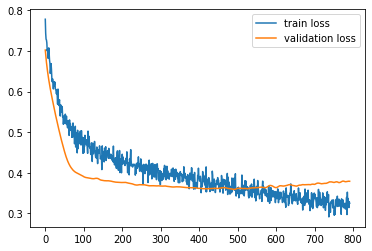

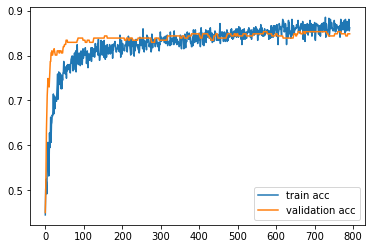

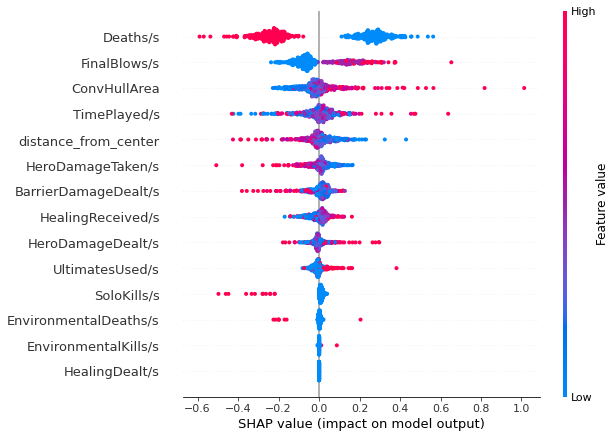

Soldier: 76
(398, 14) (398,)
X_train shape :  (266, 14)
y_train shape :  (266,)
X_test shape :  (132, 14)
y_test shape :  (132,)
Model: "sequential_46"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_138 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_92 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_139 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_93 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_140 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
______________________________________________________

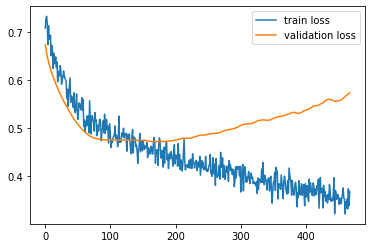

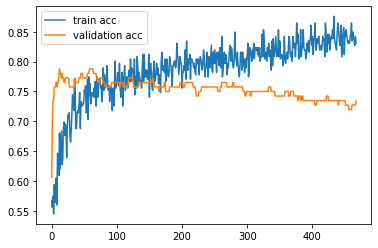

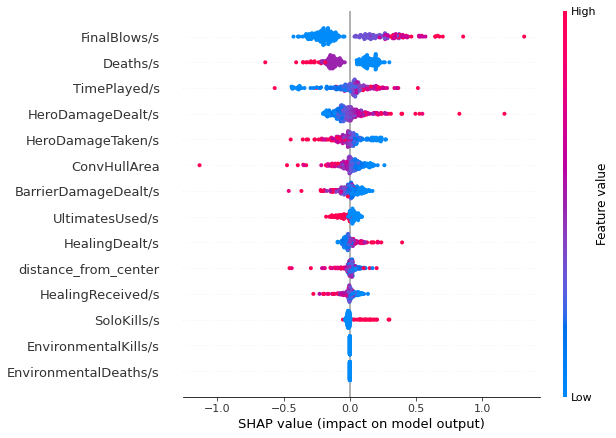

Sombra
(1124, 14) (1124,)
X_train shape :  (753, 14)
y_train shape :  (753,)
X_test shape :  (371, 14)
y_test shape :  (371,)
Model: "sequential_48"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_144 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_96 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_145 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_97 (Dropout)         (None, 64)                0         
_________________________________________________________________
dense_146 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
_________________________________________________________

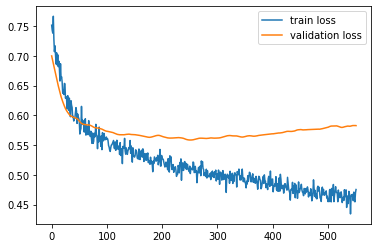

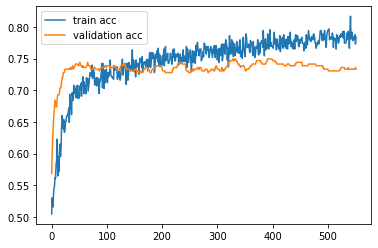

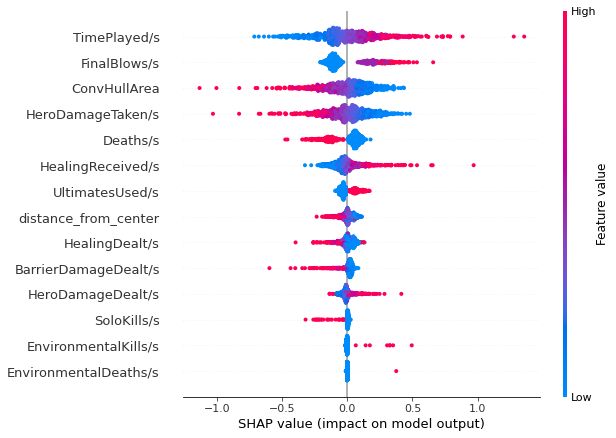

Symmetra
(769, 14) (769,)
X_train shape :  (515, 14)
y_train shape :  (515,)
X_test shape :  (254, 14)
y_test shape :  (254,)
Model: "sequential_50"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_150 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_100 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_151 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_101 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_152 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
_________________________________________________________

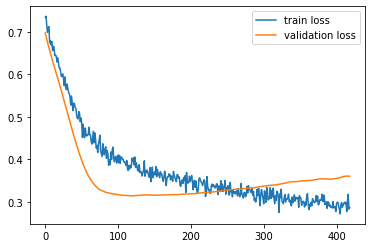

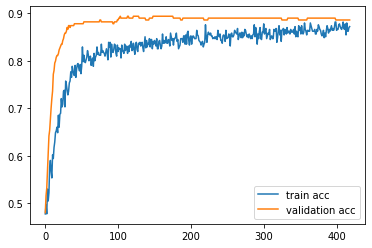

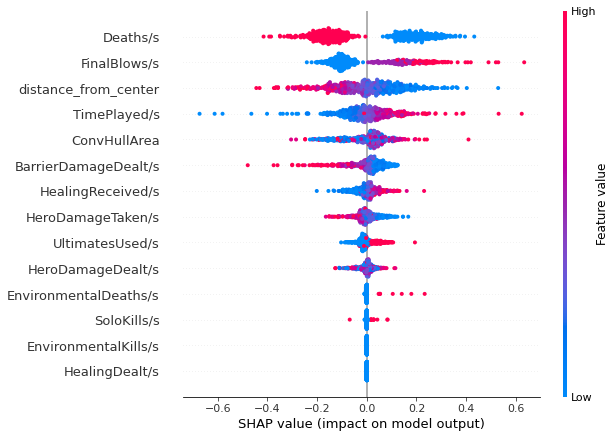

Torbjorn
(134, 14) (134,)
X_train shape :  (89, 14)
y_train shape :  (89,)
X_test shape :  (45, 14)
y_test shape :  (45,)
Model: "sequential_52"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_156 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_104 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_157 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_105 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_158 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
_____________________________________________________________

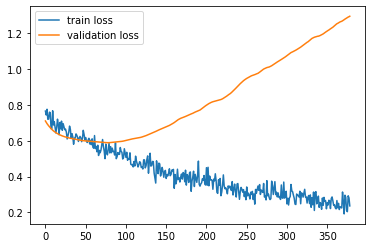

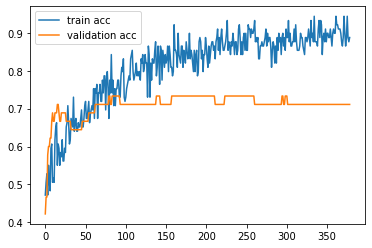

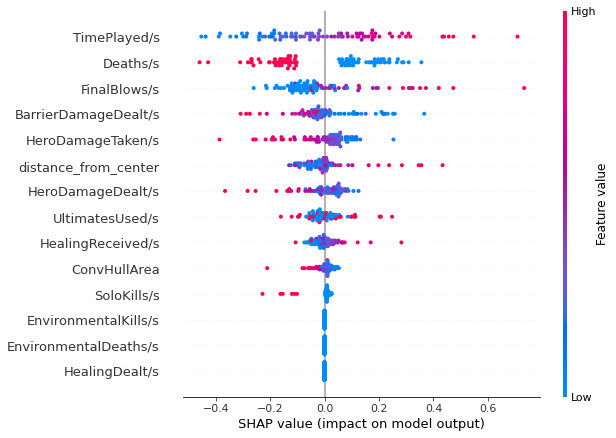

Tracer
(1560, 14) (1560,)
X_train shape :  (1045, 14)
y_train shape :  (1045,)
X_test shape :  (515, 14)
y_test shape :  (515,)
Model: "sequential_54"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_162 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_108 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_163 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_109 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_164 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
_______________________________________________________

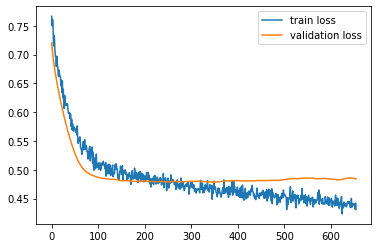

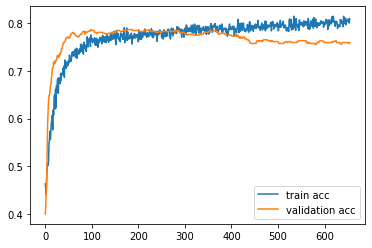

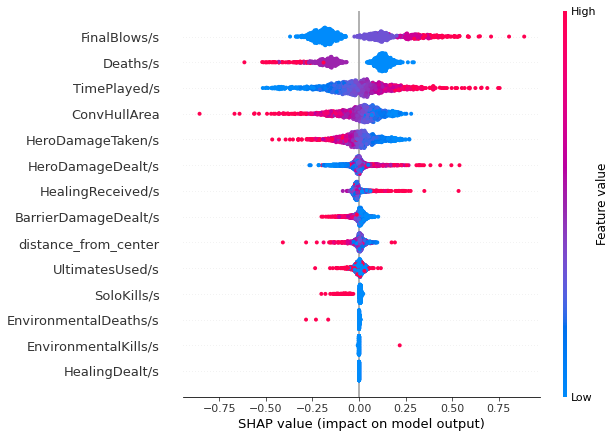

Widowmaker
(60, 14) (60,)
X_train shape :  (40, 14)
y_train shape :  (40,)
X_test shape :  (20, 14)
y_test shape :  (20,)
Model: "sequential_56"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_168 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_112 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_169 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_113 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_170 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
_____________________________________________________________

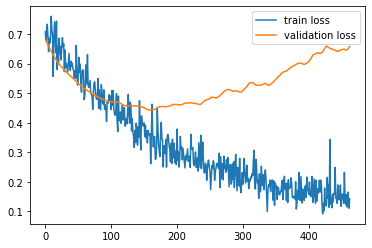

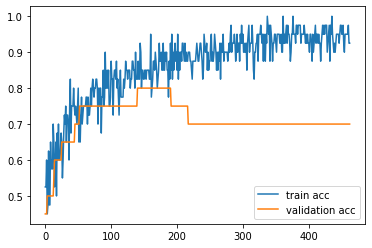

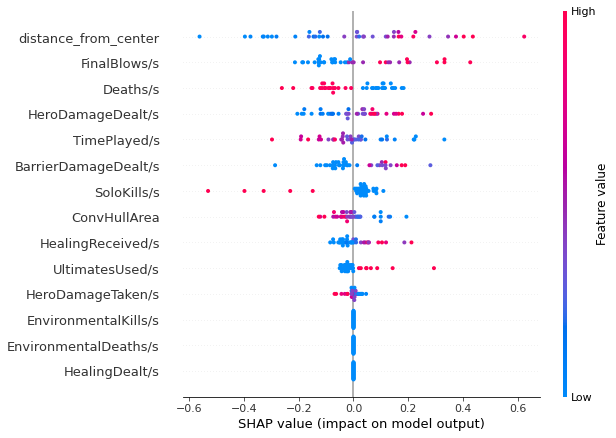

Winston
(1444, 14) (1444,)
X_train shape :  (967, 14)
y_train shape :  (967,)
X_test shape :  (477, 14)
y_test shape :  (477,)
Model: "sequential_58"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_174 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_116 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_175 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_117 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_176 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
________________________________________________________

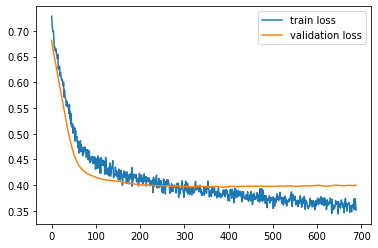

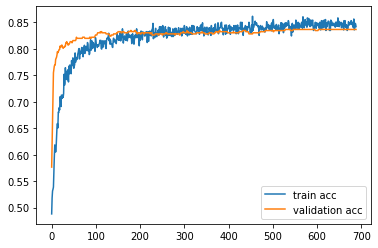

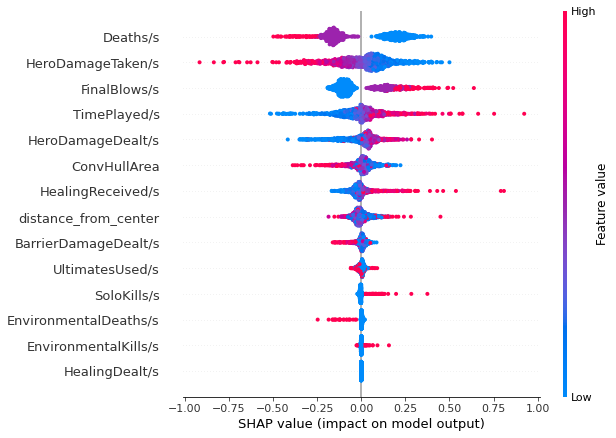

Wrecking Ball
(1814, 14) (1814,)
X_train shape :  (1215, 14)
y_train shape :  (1215,)
X_test shape :  (599, 14)
y_test shape :  (599,)
Model: "sequential_60"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_180 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_120 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_181 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_121 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_182 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
________________________________________________

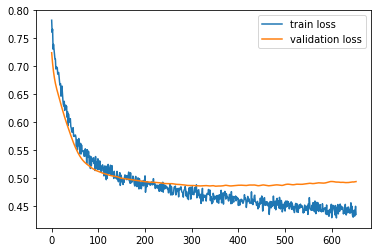

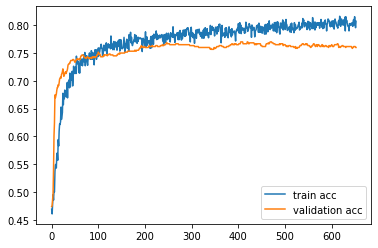

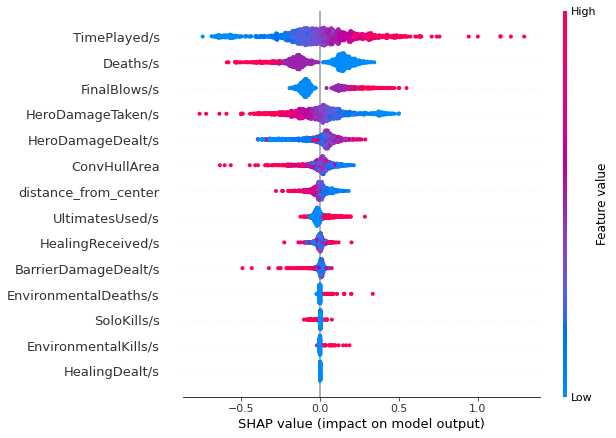

Zarya
(464, 14) (464,)
X_train shape :  (310, 14)
y_train shape :  (310,)
X_test shape :  (154, 14)
y_test shape :  (154,)
Model: "sequential_62"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_186 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_124 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_187 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_125 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_188 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
____________________________________________________________

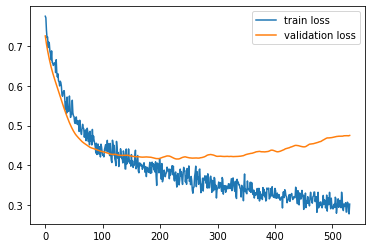

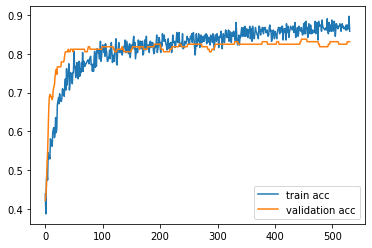

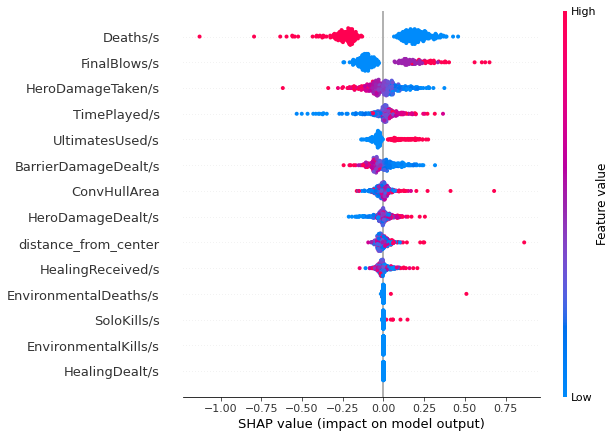

Zenyatta
(922, 14) (922,)
X_train shape :  (617, 14)
y_train shape :  (617,)
X_test shape :  (305, 14)
y_test shape :  (305,)
Model: "sequential_64"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_192 (Dense)            (None, 64)                960       
_________________________________________________________________
dropout_128 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_193 (Dense)            (None, 64)                4160      
_________________________________________________________________
dropout_129 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_194 (Dense)            (None, 1)                 65        
Total params: 5,185
Trainable params: 5,185
Non-trainable params: 0
_________________________________________________________

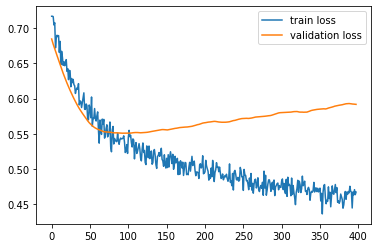

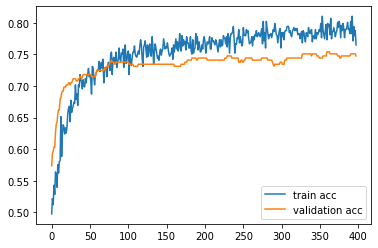

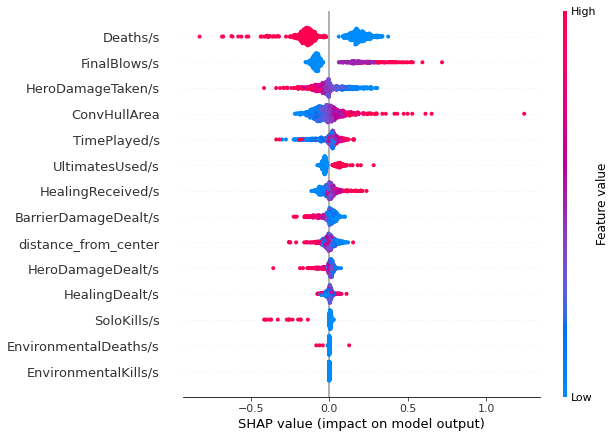

In [40]:
df_X_norm_list = []
df_y_list = []

for hero_name in HeroList:
    try:
        df_X_norm_list.append(df_X_norm.xs(hero_name, level='Hero'))
        df_y_list.append(df_y.xs(hero_name, level='Hero'))
        print(hero_name)
        learning(df_X_norm.xs(hero_name, level='Hero'), df_y.xs(hero_name, level='Hero'))
    except:
        print(f'{hero_name} is not played')
        HeroList.remove(hero_name)


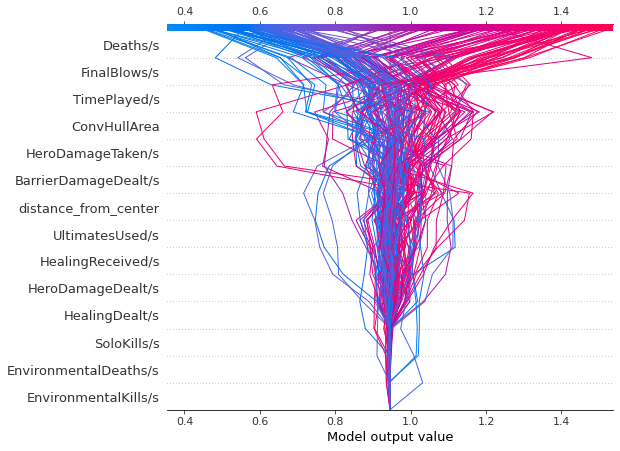

In [41]:
y_hat = dnn.model.predict(dnn.X_train[:150])
shap.decision_plot(y_hat[0], shap_values[0][:150], feature_names)

## 개별 항목 SHAP Explaination

In [42]:
df = df_X.reset_index()
df[(df['Team'] == 'New York Excelsior') & (df['MatchId']==37362)]

,MatchId,num_map,Map,Section,TF_order,Team,Player,Hero,FinalBlows/s,Deaths/s,...,BarrierDamageDealt/s,HeroDamageTaken/s,HealingDealt/s,HealingReceived/s,EnvironmentalDeaths/s,EnvironmentalKills/s,SoloKills/s,UltimatesUsed/s,distance_from_center,ConvHullArea
23433,37362,1,Nepal,1.0,1.0,New York Excelsior,Flora,Tracer,0.0,1.0,...,0.0000,433.359,0.000,147.214,0.0,0.0,0.0,1.0,8.258713,5894.729108
23434,37362,1,Nepal,1.0,1.0,New York Excelsior,Friday,Brigitte,0.0,1.0,...,0.0000,765.758,1179.405,566.058,0.0,0.0,0.0,0.0,4.980134,5894.729108
23435,37362,1,Nepal,1.0,1.0,New York Excelsior,Gwangboong,McCree,1.0,2.0,...,0.0000,1346.830,0.000,896.828,0.0,0.0,0.0,0.0,7.072125,5894.729108
23436,37362,1,Nepal,1.0,1.0,New York Excelsior,JJonak,Ana,0.0,1.0,...,0.0000,484.727,1964.120,298.241,0.0,0.0,0.0,1.0,5.980140,5894.729108
23437,37362,1,Nepal,1.0,1.0,New York Excelsior,Kalios,D.Va,1.0,1.0,...,0.0000,1919.220,0.000,1194.810,0.0,0.0,0.0,0.0,7.238916,5894.729108
23438,37362,1,Nepal,1.0,1.0,New York Excelsior,Yakpung,Wrecking Ball,0.0,1.0,...,0.0000,1534.670,0.000,437.442,0.0,0.0,0.0,0.0,7.712675,5894.729108
23445,37362,1,Nepal,1.0,2.0,New York Excelsior,Flora,Tracer,0.0,1.0,...,0.0000,180.187,0.000,0.000,0.0,0.0,0.0,0.0,2.736336,2259.911710
23446,37362,1,Nepal,1.0,2.0,New York Excelsior,Friday,Brigitte,0.0,1.0,...,0.0000,390.202,338.440,190.203,0.0,0.0,0.0,0.0,2.751147,2259.911710
23447,37362,1,Nepal,1.0,2.0,New York Excelsior,Gwangboong,McCree,0.0,1.0,...,0.0000,918.980,0.000,617.915,0.0,0.0,0.0,0.0,2.570390,2259.911710
23448,37362,1,Nepal,1.0,2.0,New York Excelsior,JJonak,Ana,0.0,0.0,...,0.0000,19.628,557.680,0.000,0.0,0.0,0.0,0.0,1.122609,2259.911710


(37212, 1, 'Lijiang Tower', 2.0, 3.0, 'London Spitfire', 'Hybrid', 'McCree') 0 vs  (37212, 1, 'Lijiang Tower', 2.0, 3.0, 'London Spitfire', 'Hybrid', 'Symmetra') 0


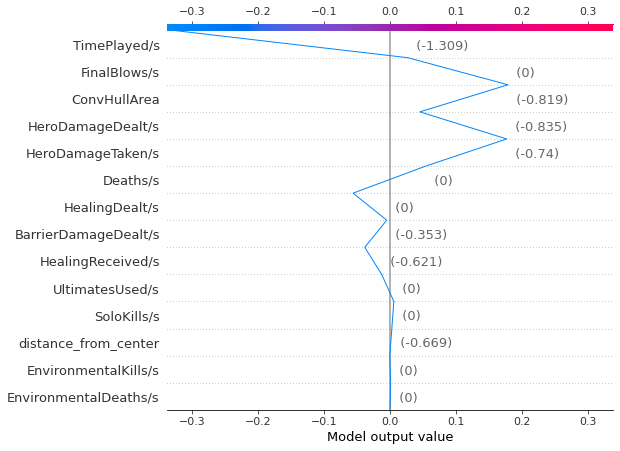

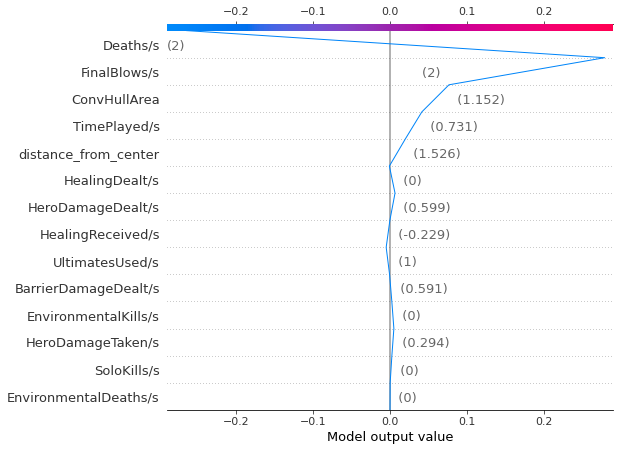

In [43]:
i = 844
if i % 2 == 0: 
    j = i + 1
else: 
    j = i - 1

# inverse_X_train = scaler.inverse_transform(dnn.X_train)

print(df_X_norm.index[i], dnn.y_train[i], 'vs ', df_X_norm.index[j], dnn.y_train[j])
shap.decision_plot(dnn.y_train[i], shap_values[0][i], dnn.X_train[i], feature_names=feature_names.tolist())
shap.decision_plot(dnn.y_train[j], shap_values[0][j], dnn.X_train[j], feature_names=feature_names.tolist())

## LSTM

In [44]:
lstm = ModelLSTM(X=X, y=y, time_shift=5)
lstm.create_model()

X_train shape :  (20414, 14)
y_train shape :  (20414,)
X_test shape :  (10056, 14)
y_test shape :  (10056,)
-------Reshape-----------
input shape: (20414, 14)


ValueError: cannot reshape array of size 285796 into shape (20414,5,2)

In [ ]:
lstm.train_model(num_epoch=30000, batch_size=5000, patience=300, verbose=0)
lstm.model.evaluate(lstm.X_test, lstm.y_test, batch_size=3000, verbose=0)